In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session


# 📚 Import Libraries

In [50]:
import copy
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
import seaborn as sns
import skimage
from skimage import io, transform
from sklearn.metrics import confusion_matrix
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from torchvision import datasets, models, transforms
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from torch.autograd import Variable

# 📂 Load Dataset

The dataset respective to already classified category is divided into three sets:
* test set
* train set
* validation set


In [51]:
EPOCHS = 1
data_dir = "/kaggle/input/chest-xray-pneumonia/chest_xray"
TEST = 'test'
TRAIN = 'train'
VAL ='val'

# 🚀 Data Preprocessing and Augmentation

Deep learning models typically require a substantial amount of data for training. Generally, the more data available, the better the model's performance. 📈

**Image Augmentation** 🎨 is a technique used to generate new images for training our deep learning model. These new images are created using the existing training images, eliminating the need for manual collection. 

In [52]:
# Define a function for data transformations
def data_transforms(phase):
    # If the phase is TRAIN
    if phase == TRAIN:
        # Compose transformations: Resize, CenterCrop, Convert to Tensor, Normalize
        transform = transforms.Compose([
            transforms.Resize(256),  # Resize the image to 256x256 pixels
            transforms.CenterCrop(224),  # Crop the center of the image to 224x224 pixels
            transforms.ToTensor(),  # Convert the image to a PyTorch Tensor
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),  # Normalize the Tensor
        ])
        
    # If the phase is VAL
    if phase == VAL:
        # Apply the same transformations as the TRAIN phase
        transform = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
        ])
    
    # If the phase is TEST
    if phase == TEST:
        # Apply the same transformations as the TRAIN phase
        transform = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
        ])        
        
    return transform  # Return the composed transformations

# Check if CUDA is available and set the device accordingly
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)  # Print the device being used


cuda:0


In [53]:
# Create a dictionary of datasets for each phase (TRAIN, VAL, TEST)
# For each phase, load the images from the corresponding folder and apply the data transformations
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x), data_transforms(x)) 
                  for x in [TRAIN, VAL, TEST]}

# Create a dictionary of dataloaders for each phase
# For each phase, create a DataLoader that loads the data from the corresponding dataset
# The batch size and shuffle parameters can be adjusted as needed
dataloaders = {
    TRAIN: torch.utils.data.DataLoader(image_datasets[TRAIN], batch_size = 4, shuffle=True), 
    VAL: torch.utils.data.DataLoader(image_datasets[VAL], batch_size = 1, shuffle=True), 
    TEST: torch.utils.data.DataLoader(image_datasets[TEST], batch_size = 1, shuffle=True)
}

In [54]:
# Class Distribution Visualization
def plot_class_distribution():
    class_counts = pd.Series(image_datasets[TRAIN].targets).value_counts().sort_index()
    fig = px.bar(x=class_names, y=class_counts, labels={'x': 'Class', 'y': 'Count'},
                 title='Class Distribution in Training Set', color=class_names)
    fig.show()

plot_class_distribution()

In [55]:
len(dataloaders[TRAIN])

1304

In [56]:
# Get the sizes of the datasets
dataset_sizes = {
    x: len(image_datasets[x]) 
    for x in [TRAIN, VAL]
}

# Get the classes from the training dataset
classes = image_datasets[TRAIN].classes

# Get the class names from the training dataset
class_names = image_datasets[TRAIN].classes


# 🖼️Visualizing the Chest X-rays

In [57]:
# Image Grid with Plotly
def plot_interactive_images():
    fig = make_subplots(rows=6, cols=6, subplot_titles=[f"Image {i+1}" for i in range(36)])
    for i in range(6):
        for j in range(6):
            inputs, classes = next(iter(dataloaders[TRAIN]))
            input_img = inputs[0].numpy().transpose((1, 2, 0))
            mean = np.array([0.485, 0.456, 0.406])
            std = np.array([0.229, 0.224, 0.225])
            inp = std * input_img + mean
            inp = np.clip(inp, 0, 1)
            fig.add_trace(go.Image(z=(inp * 255).astype(np.uint8)), row=i+1, col=j+1)
            fig.update_xaxes(showgrid=False, zeroline=False, row=i+1, col=j+1)
            fig.update_yaxes(showgrid=False, zeroline=False, row=i+1, col=j+1)
            fig.layout.annotations[i*6 + j]['text'] = class_names[classes[0].item()]
    fig.update_layout(height=1200, width=1200, title_text="Chest X-ray Samples")
    fig.show()

plot_interactive_images()

In [58]:
inputs, classes = next(iter(dataloaders[TRAIN]))

# 🚀Define Function for Training

In [59]:
def train_model(model, criterion, optimizer, scheduler, num_epochs):
    # Save the initial model weights
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    
    # Loop over the number of epochs
    for epoch in range(num_epochs):
        print("Epoch: {}/{}".format(epoch+1, num_epochs))
        print("="*10)
        
        # Each epoch has a training and validation phase
        for phase in [TRAIN, VAL]:
            if phase == TRAIN:
                scheduler.step()
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data
            for data in dataloaders[phase]:
                inputs, labels = data
                inputs = inputs.to(device)
                labels = labels.to(device)

                # Zero the parameter gradients
                optimizer.zero_grad()

                # Forward pass
                with torch.set_grad_enabled(phase==TRAIN):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # Backward pass and optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # Statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            # Deep copy the model if we have a new best validation accuracy
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

    print('Best val Acc: {:4f}'.format(best_acc))

    # Load best model weights and return the model
    model.load_state_dict(best_model_wts)
    return model


# 🔄Load the Pretrained Model

In [29]:
model_pre = models.vgg16()
model_pre.load_state_dict(torch.load("/kaggle/input/pytorch-pretrain-model/pytorch/default/1/vgg16-397923af.pth"))

<ipython-input-29-622a09f99938>:2: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.



<All keys matched successfully>

In [60]:
for param in model_pre.features.parameters():
    param.required_grad = False

num_features = model_pre.classifier[6].in_features
features = list(model_pre.classifier.children())[:-1] 
features.extend([nn.Linear(num_features, len(class_names))])
model_pre.classifier = nn.Sequential(*features) 
print(model_pre)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

# 🔧Define the Hyperparameters

In [61]:
model_pre = model_pre.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model_pre.parameters(), lr=0.001, momentum=0.9, weight_decay=0.01)
# Decay LR by a factor of 0.1 every 10 epochs
exp_lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

# 🚂Train Phase

In [32]:
model_pre = train_model(model_pre, criterion, optimizer, exp_lr_scheduler, num_epochs=EPOCHS)

Epoch: 1/1


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:224: UserWarning:

Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate



train Loss: 0.1662 Acc: 0.9358
val Loss: 0.4431 Acc: 0.6875
Best val Acc: 0.687500


# Grad-CAM Implementation

In [62]:
def get_gradcam(model, image, target_class):
    model.eval()
    image = image.to(device)
    image.requires_grad = True
    output = model(image)
    model.zero_grad()
    output[0, target_class].backward()
    gradients = image.grad.data
    pooled_gradients = torch.mean(gradients, dim=[0, 2, 3])
    activations = model.features(image).detach()
    for i in range(activations.size(1)):
        activations[:, i, :, :] *= pooled_gradients[i]
    heatmap = torch.mean(activations, dim=1).squeeze().cpu()
    heatmap = np.maximum(heatmap, 0)
    heatmap /= torch.max(heatmap)
    return heatmap.numpy()

# 📊Evaluate Model Performance

In [63]:
def test_model():
    # Initialize counters
    running_correct = 0.0
    running_total = 0.0
    true_labels = []
    pred_labels = []
    input_images = []

    # No need to track gradients for testing
    with torch.no_grad():
        # Iterate over test data
        for data in dataloaders[TEST]:
            inputs, labels = data
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Store true labels
            true_labels.append(labels.item())
            
            #Store model input images
            input_images.append(inputs)
            
            # Forward pass
            outputs = model_pre(inputs)
            _, preds = torch.max(outputs.data, 1)

            # Store predicted labels
            pred_labels.append(preds.item())

            # Update counters
            running_total += labels.size(0)
            running_correct += (preds == labels).sum().item()

        # Calculate accuracy
        acc = running_correct / running_total

    return true_labels, pred_labels, input_images,  running_correct, running_total, acc

# 🧪Testing Phase

In [64]:
true_labels, pred_labels, input_images, running_correct, running_total, acc = test_model()

# Confusion Matrix Heatmap

In [65]:
cm = confusion_matrix(true_labels, pred_labels)
fig = px.imshow(cm, text_auto=True, labels=dict(x="Predicted", y="True", color="Count"),
                x=class_names, y=class_names, title="Confusion Matrix")
fig.show()

# 📈 Results

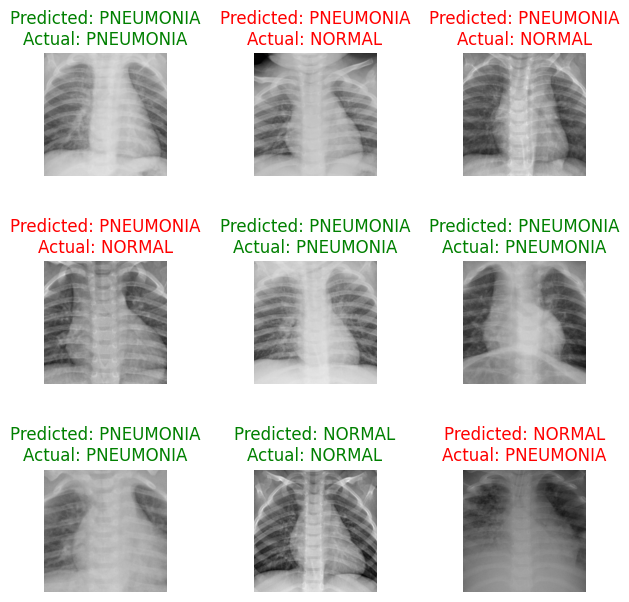

In [66]:
fig, axes = plt.subplots(3,3, figsize=(7, 7))
fig.subplots_adjust(hspace=0.7, wspace=0.7)
x=0
for i in range(3):
    for j in range(3):
        # Get the image and labels
        inp = input_images[x].squeeze()
      
        true_label = true_labels[x]
        pred_label = pred_labels[x]

        # Normalize the image for display
        inp = inp.cpu().numpy().transpose((1, 2, 0))
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        inp = std * inp + mean
        inp = np.clip(inp, 0, 1)

        # Display the image
        axes[i, j].imshow(inp)

        # Set the title with the predicted and actual labels
        title = "Predicted: {}\nActual: {}".format(class_names[pred_label], class_names[true_label])
        color = 'green' if pred_label == true_label else 'red'
        axes[i, j].set_title(title, color=color)

        # Hide the axes
        axes[i, j].axis('off')

        # Move to the next image
        x += 1

plt.show()

In [67]:
import plotly.graph_objects as go

# Print Results
print("Total Correct: {} \nTotal Test Images: {}".format(running_correct, running_total))
print("Test Accuracy: ", acc)

# Bar Chart: Total Correct vs Total Images
fig_bar = go.Figure(data=[
    go.Bar(name='Correct Predictions', x=['Results'], y=[running_correct], marker_color='green'),
    go.Bar(name='Total Test Images', x=['Results'], y=[running_total], marker_color='gray')
])
fig_bar.update_layout(title_text="Prediction Summary", barmode='group')
fig_bar.show()

# Gauge Chart: Accuracy
fig_gauge = go.Figure(go.Indicator(
    mode="gauge+number+delta",
    value=acc * 100,
    delta={'reference': 100, 'increasing': {'color': "red"}},
    title={'text': "Test Accuracy (%)"},
    gauge={
        'axis': {'range': [None, 100]},
        'bar': {'color': "blue"},
        'steps': [
            {'range': [0, 50], 'color': "red"},
            {'range': [50, 75], 'color': "orange"},
            {'range': [75, 90], 'color': "yellow"},
            {'range': [90, 100], 'color': "green"}
        ],
    }
))
fig_gauge.update_layout(height=400, title_text="Model Performance Gauge")
fig_gauge.show()


Total Correct: 419.0 
Total Test Images: 624.0
Test Accuracy:  0.6714743589743589


In [2]:
from flask import Flask, request, jsonify
import torch
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
import io
import os
import socket
import threading
import time

# Initialize Flask app
app = Flask(__name__)

# Configuration
MODEL_PATH = "/kaggle/input/pytorch-pretrain-model/pytorch/default/1/vgg16-397923af.pth"
ALLOWED_EXTENSIONS = {'png', 'jpg', 'jpeg'}
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
START_PORT = 5000  # Starting port number to check

def find_free_port(start_port):
    """Find a free port starting from start_port"""
    port = start_port
    while True:
        with socket.socket(socket.AF_INET, socket.SOCK_STREAM) as s:
            if s.connect_ex(('localhost', port)) != 0:
                return port
        port += 1
        if port > start_port + 100:  # Safety limit
            raise RuntimeError("Could not find free port in range")

def is_port_in_use(port):
    with socket.socket(socket.AF_INET, socket.SOCK_STREAM) as s:
        return s.connect_ex(('localhost', port)) == 0

def load_model():
    if not os.path.exists(MODEL_PATH):
        raise FileNotFoundError(f"Model file not found at {MODEL_PATH}")
    
    try:
        model = models.vgg16(weights=None)
        state_dict = torch.load(MODEL_PATH, map_location=DEVICE, weights_only=True)
        model.load_state_dict(state_dict)
        model.to(DEVICE)
        model.eval()
        print("Model loaded successfully!")
        return model
    except Exception as e:
        raise RuntimeError(f"Error loading model: {str(e)}")

# Load model at startup
try:
    model = load_model()
except Exception as e:
    print(f"Fatal error during model loading: {e}")
    model = None

# Image transformation
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

def allowed_file(filename):
    return '.' in filename and filename.rsplit('.', 1)[1].lower() in ALLOWED_EXTENSIONS

@app.route('/predict', methods=['POST'])
def predict():
    if model is None:
        return jsonify({"error": "Model is not available"}), 503
    
    if 'file' not in request.files:
        return jsonify({"error": "No file uploaded"}), 400
    
    file = request.files['file']
    
    if file.filename == '':
        return jsonify({"error": "No selected file"}), 400
    
    if not allowed_file(file.filename):
        return jsonify({"error": "Invalid file type"}), 400
    
    try:
        image = Image.open(io.BytesIO(file.read()))
        if image.mode != 'RGB':
            image = image.convert('RGB')
        
        image_tensor = transform(image).unsqueeze(0).to(DEVICE)
        
        with torch.no_grad():
            output = model(image_tensor)
            prediction = torch.argmax(output, dim=1).item()
        
        result = "Pneumonia Detected" if prediction == 1 else "Normal"
        return jsonify({
            "prediction": result,
            "confidence": torch.max(torch.softmax(output, dim=1)).item()
        })
    
    except Exception as e:
        return jsonify({"error": f"Error processing image: {str(e)}"}), 500

@app.route('/health', methods=['GET'])
def health_check():
    if model is not None:
        return jsonify({"status": "healthy", "model": "loaded"}), 200
    return jsonify({"status": "unhealthy", "model": "not loaded"}), 503

def start_server():
    try:
        # Find a free port
        port = find_free_port(START_PORT)
        
        print("\n====================================")
        print(f"Starting server on: http://127.0.0.1:{port}")
        print("====================================\n")
        print("Available endpoints:")
        print(f"POST http://127.0.0.1:{port}/predict - Upload an image for pneumonia detection")
        print(f"GET http://127.0.0.1:{port}/health - Check server and model status")
        
        # Start Flask in a separate thread
        threading.Thread(
            target=app.run,
            kwargs={'host': '0.0.0.0', 'port': port, 'debug': False, 'use_reloader': False}
        ).start()
        
        # Verify server is actually running
        time.sleep(1)
        if is_port_in_use(port):
            print(f"Server successfully started on port {port}")
            return True, port
        else:
            print("Failed to start server!")
            return False, None
    except Exception as e:
        print(f"Error starting server: {e}")
        return False, None

if __name__ == '__main__':
    success, port = start_server()
    if success:
        try:
            # Keep the main thread alive
            while True:
                time.sleep(1)
        except KeyboardInterrupt:
            print("\nShutting down server...")
    else:
        print("Server failed to start. Please check the error messages above.")

Model loaded successfully!

Starting server on: http://127.0.0.1:5000

Available endpoints:
POST http://127.0.0.1:5000/predict - Upload an image for pneumonia detection
GET http://127.0.0.1:5000/health - Check server and model status
 * Serving Flask app '__main__'
 * Debug mode: off
Server successfully started on port 5000

Shutting down server...
